In [1]:
from IPython.display import HTML, display,Image

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

<center style="color:black;font-size:30px;">Static stability and bouyancy frequency</center>


1. [Data description](#Data-description)
2. [Downloading data](#Downloading-data)
3. [Reading data](#Reading-data)
4. [Exploring data](#Exploring-data)
5. [Static Stability and Brunt Vesala frecuency](#Static-Stability-and-Brunt-Vesala-frecuency)
6. [Animation of static stability and its relation with bouyancy frecuency](#Animation-of-static-stability-and-its-relation-with-bouyancy-frecuency)


In [2]:
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import xarray as xr
from matplotlib import animation
import cartopy.crs as ccrs
import cartopy
import cartopy.feature as cfeature
import pandas as pd
import matplotlib.gridspec as gridspec
import os.path
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from matplotlib.dates import DateFormatter
import matplotlib.dates as mdates
import wget

xr.set_options(display_style="html")

import matplotlib.font_manager
matplotlib.font_manager._rebuild()

# Set common figure parameters
plt.style.use('seaborn-ticks')

newparams = { 'axes.grid': True,
             'lines.linewidth': 1.5, 'lines.linewidth': 2,
             'ytick.labelsize':15,
             'xtick.labelsize':15,
             'axes.labelsize':16,
             'axes.titlesize':16,
            'legend.fontsize':14,
             'figure.titlesize':16,
            'font.family':'Helvetica Light'}
#             'font.family':'DejaVu Sans'}
plt.rcParams.update(newparams)

In [5]:
try:
    import seawater
except ModuleNotFoundError:
    !pip install seawater # the install function from the question

In [6]:
def simpleaxis(ax):
    ax.spines['bottom'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.get_xaxis().tick_top()
    ax.get_yaxis().tick_left()
    ax.xaxis.set_label_position('top') 

In [7]:
def zoomed_ax(ax_padre,ax_hijo,location,limits_x,limits_y,color):
    ax=ax_padre.inset_axes(location, transform=ax_padre.transData)
    ax.set_facecolor((1, 1, 1,0))
    ax.set(xlim=limits_x,ylim=limits_y,xticklabels=[],yticklabels=[],xticks=[],yticks=[])
    ax_hijo.set(xlim=limits_x,ylim=limits_y,xticklabels=[],yticklabels=[],xticks=[],yticks=[])
    ax.invert_yaxis()
    ax.indicate_inset_zoom(ax_hijo, edgecolor=color)

    return ax_padre,ax_hijo,ax

In [8]:
def make_patch_spines_invisible(ax):
    ax.set_frame_on(True)
    ax.patch.set_visible(False)
    for sp in ax.spines.values():
        sp.set_visible(False)

# Data description

Argo is a real-time global ocean in situ observing system.


*Argo* is a global network of nearly 4000 autonomous probes measuring pressure, temperature and salinity from the surface to 2000m depth every 10 days. The localisation of these probes is nearly random between the 60th parallels (see live coverage here). All probes data are collected by satellite in real-time, processed by several data centers and finally merged in a single dataset (collecting more than 2 millions of vertical profiles data) made freely available to anyone through a ftp server or monthly zip snapshots.

An example of the Argo cycle program is shown in this [link](https://argopy.readthedocs.io/en/latest/):

# Downloading data

The data registered by each float can be dowloaded from [Argo's official website](https://argo.ucsd.edu/). The data can be downloaded via ftp or http. For this example the float with ID 5906017 was selected and the .nc file was obtained from this [link](https://www.ncei.noaa.gov/data/oceans/argo/gadr/data/aoml/5906017/) using wget, a Python library.

In [9]:
name_file='nodc_5906017_prof.nc'
print('Verifing existence of {}'.format(name_file))
print('..')
print('..')
print('..')
if os.path.isfile(name_file) == False:
    file=wget.download('https://www.ncei.noaa.gov/data/oceans/argo/gadr/data/aoml/5906017/nodc_5906017_prof.nc')
    print("The file {} was just downloaded".format(file))
else:
    print("The file {} already is in the directory".format(name_file))
    

Verifing existence of nodc_5906017_prof.nc
..
..
..
The file nodc_5906017_prof.nc already is in the directory


# Reading data

The .nc file is readed with Xarray library. Four tabs are printed: *Dimensions*, *Coordinates*, *Data variables* and *Atributes*. More specific information is shown in the down drop tabs. 

- **Data Variables:**  contains all variables with their respective information about dimensions, type of variable,etc.
- **Atributes:** describe extra information as metadata, conventions, owner, etc.

Please check tabs and take a look at all information that you consider important.

In [10]:
data = xr.open_dataset('nodc_5906017_prof.nc')
data

<xarray.Dataset>
Dimensions:                       (n_calib: 1, n_history: 0, n_levels: 511, n_param: 3, n_prof: 57)
Dimensions without coordinates: n_calib, n_history, n_levels, n_param, n_prof
Data variables:
    data_type                     object ...
    format_version                object ...
    handbook_version              object ...
    reference_date_time           object ...
    date_creation                 object ...
    date_update                   object ...
    platform_number               (n_prof) object ...
    project_name                  (n_prof) object ...
    pi_name                       (n_prof) object ...
    station_parameters            (n_prof, n_param) object ...
    cycle_number                  (n_prof) float64 ...
    direction                     (n_prof) object ...
    data_centre                   (n_prof) object ...
    dc_reference                  (n_prof) object ...
    data_state_indicator          (n_prof) object ...
    data_mode                     (n_prof) object ...
    platform_type                 (n_prof) object ...
    float_serial_no               (n_prof) object ...
    firmware_version              (n_prof) object ...
    wmo_inst_type                 (n_prof) object ...
    juld                          (n_prof) datetime64[ns] ...
    juld_qc                       (n_prof) object ...
    juld_location                 (n_prof) datetime64[ns] ...
    latitude                      (n_prof) float64 ...
    longitude                     (n_prof) float64 ...
    position_qc                   (n_prof) object ...
    positioning_system            (n_prof) object ...
    profile_pres_qc               (n_prof) object ...
    profile_temp_qc               (n_prof) object ...
    profile_psal_qc               (n_prof) object ...
    vertical_sampling_scheme      (n_prof) object ...
    config_mission_number         (n_prof) float64 ...
    pres                          (n_prof, n_levels) float32 ...
    pres_qc                       (n_prof, n_levels) object ...
    pres_adjusted                 (n_prof, n_levels) float32 ...
    pres_adjusted_qc              (n_prof, n_levels) object ...
    pres_adjusted_error           (n_prof, n_levels) float32 ...
    temp                          (n_prof, n_levels) float32 ...
    temp_qc                       (n_prof, n_levels) object ...
    temp_adjusted                 (n_prof, n_levels) float32 ...
    temp_adjusted_qc              (n_prof, n_levels) object ...
    temp_adjusted_error           (n_prof, n_levels) float32 ...
    psal                          (n_prof, n_levels) float32 ...
    psal_qc                       (n_prof, n_levels) object ...
    psal_adjusted                 (n_prof, n_levels) float32 ...
    psal_adjusted_qc              (n_prof, n_levels) object ...
    psal_adjusted_error           (n_prof, n_levels) float32 ...
    parameter                     (n_prof, n_calib, n_param) object ...
    scientific_calib_equation     (n_prof, n_calib, n_param) object ...
    scientific_calib_coefficient  (n_prof, n_calib, n_param) object ...
    scientific_calib_comment      (n_prof, n_calib, n_param) object ...
    scientific_calib_date         (n_prof, n_calib, n_param) object ...
    history_institution           (n_history, n_prof) object ...
    history_step                  (n_history, n_prof) object ...
    history_software              (n_history, n_prof) object ...
    history_software_release      (n_history, n_prof) object ...
    history_reference             (n_history, n_prof) object ...
    history_date                  (n_history, n_prof) object ...
    history_action                (n_history, n_prof) object ...
    history_parameter             (n_history, n_prof) object ...
    history_start_pres            (n_history, n_prof) float32 ...
    history_stop_pres             (n_history, n_prof) float32 ...
    history_previous_value        (n_history, n_prof) float32 ...
    history_qctest                (n_hi

# Exploring data

Before to start a more-advanced manipulations of this data, it is important to know: what format the data is? If there is time-varying data: What is the data period and frecuency?. In the argo data, 3D variability is expected so a map with the float location in any date is plotted.

In [11]:
time_str=data.juld.dt.strftime('%Y-%m-%d %H:%M:%S')
time_str2=data.juld.dt.strftime('%y-%m-%d')
time=pd.to_datetime(time_str.values)
time2=pd.to_datetime(time_str2.values)

In [12]:
days=(time-time[0]).days

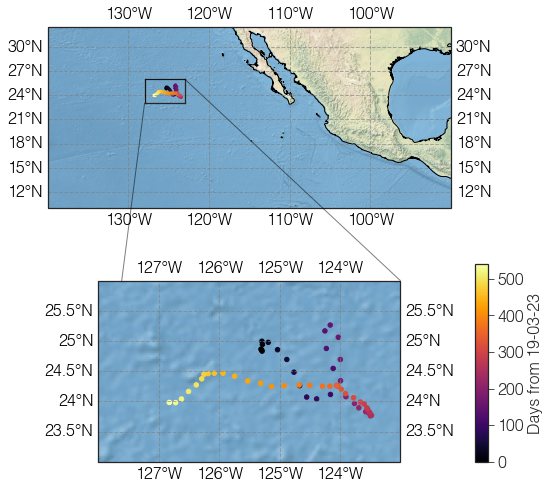

In [13]:
fig=plt.figure(figsize=(12,8))               

# Setting parent axes
ax1=fig.add_subplot(2,1,1,projection=ccrs.PlateCarree())
cf=ax1.scatter(data.longitude,data.latitude,s=6,c=days,cmap='inferno')
gl1 = ax1.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=1, color='gray', alpha=0.6, linestyle='--')
gl1.xlabel_style = {'size': 16, 'color': 'black',}
gl1.ylabel_style = {'size': 16, 'color': 'black'}
# gl1.xformatter = LONGITUDE_FORMATTER

ax1.coastlines(resolution='10m')
ax1.set_extent((-140,-90,10,30))
ax1.stock_img()
# ax1.add_feature(cfeature.LAND)
# ax1.set_title('Argo float trajectorie',y=1.2)

# Setting child figure
ax2=fig.add_subplot(2,1,2,projection=ccrs.PlateCarree())
ax1,ax2,ax11=zoomed_ax(ax1,ax2,[-128,23,5,3],(-128,-123),(23,26),'k')
ax2.scatter(data.longitude,data.latitude,s=20,c=days,cmap='inferno')
gl2 = ax2.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=1, color='gray', alpha=0.6, linestyle='--')
gl2.xlocator = mticker.FixedLocator(np.arange(-128, -122,1))
gl2.xlabel_style = {'size': 16, 'color': 'black',}
gl2.ylabel_style = {'size': 16, 'color': 'black'}
# gl2.xformatter = LONGITUDE_FORMATTER

ax2.stock_img()

# Setting cbar
cax= fig.add_axes([ax2.get_position().x1+0.07,ax2.get_position().y0,0.015,ax2.get_position().height])
cbar=plt.colorbar(cf,cax=cax,orientation="vertical",pad=0.15)
cbar.set_label('Days from {}'.format(time[0].strftime("%y-%m-%d")),fontsize=16)
cbar.ax.tick_params(labelsize=16)

plt.subplots_adjust(hspace=0.4)

plt.show()

The float was drifting in front of the coast of Baja California, México with initial eastward movements. After, westward movements were more frequents. Please note that the donwloaded data covers more than year, in other words, stational variations can be reviewed.

In the next plot, all temperature profiles are shown. Notice that the surface temperature increse during certain times of the year.

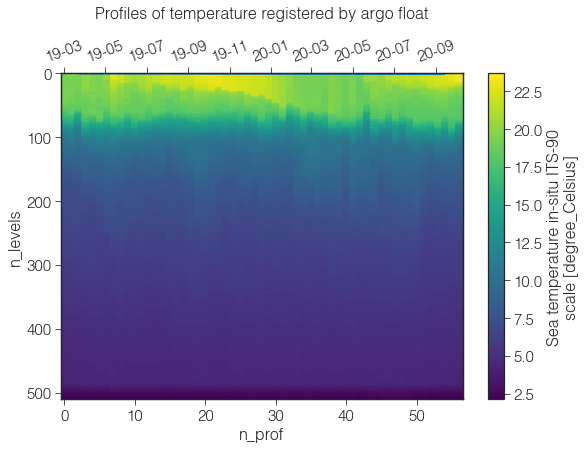

In [14]:
plt.figure(figsize=(9,6))
data.temp_adjusted.T.plot()
plt.gca().invert_yaxis()
plt.gca().set_title('Profiles of temperature registered by argo float',y=1.15)
ax2 = plt.gca().twiny()
ax2.plot(time,np.linspace(0,1,len(data.temp)),zorder=2)
date_form = DateFormatter("%y-%m")
ax2.xaxis.set_major_formatter(date_form)
plt.xticks(rotation=20)
# ax.xaxis.set_major_locator(mdates.MonthLocator(interval=10))
ax2.grid(False)
plt.show()

The lowest surface temperatures appear to occur during the first months of each year, but this will be analyzed later.

## Choosing a profile

In order to verify the temperature data, a random profile is selected and its information is plotted. Profile # 25 is selected and this will be used in future calculations from now on.

In [15]:
nprof = 25 #Specify a profile to plot

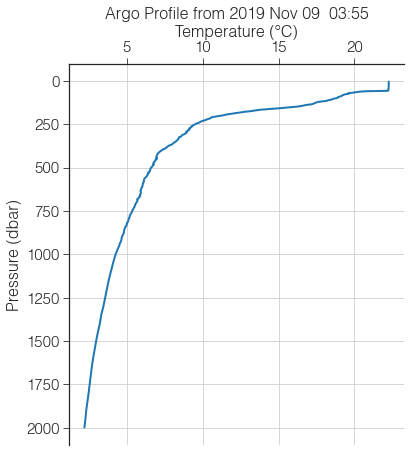

In [16]:
# Profile Plot
fig=plt.figure(figsize=(6,7))
ax=plt.subplot(111)
ax.plot(data.temp_adjusted[nprof], data.pres_adjusted[nprof])

ax.set_xlabel('Temperature (°C)')
ax.set_ylabel('Pressure (dbar)')
ax.set_title('Argo Profile from %s' % data.juld[nprof].dt.strftime('%Y %b %d  %H:%M').values)
simpleaxis(ax)
plt.gca().invert_yaxis() #Flip the y-axis

The vertical variation of the temperature cooresponds to the temperature profiles for mid-latitude locations are known. The highest values are in the surface due to is the layer that get more radation than other ones. The termhocline, a region which the temperature decreases rapidly, is present in the first 100 meters. 

## TS diagram

A TS diagram is plotted in order to check the vertical variation of temperature, salinity and finally, density. The density is calculated from the [*seawater* library](https://pythonhosted.org/seawater/). Please visit the website for further details.

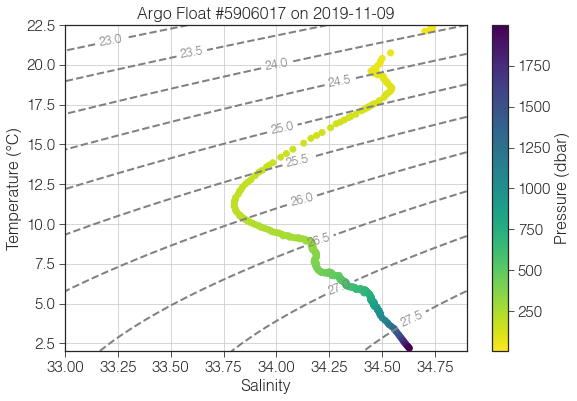

In [17]:
fig,ax=plt.subplots(1,1,figsize=(9,6))
x = np.arange(33, 35, .1)
y = np.arange(2, 23, .5)
X, Y = np.meshgrid(x, y)
Z = seawater.eos80.dens0(X,Y)-1000

# Plot the contour lines
CS = ax.contour(X, Y, Z, colors='grey', linestyles='dashed', levels=np.arange(22,30,.5))
ax.clabel(CS, inline=1, fontsize=12, fmt='%0.1f')

# Plot the data
nprof = 25 #Selected profile
sc=ax.scatter(data.psal_adjusted[nprof], data.temp_adjusted[nprof], c=data.pres_adjusted[nprof], cmap='viridis_r')
ax.set(xlabel='Salinity',ylabel='Temperature (°C)')
ax.set_title('Argo Float #%d on %s' % (data.platform_number[nprof].values, data.juld[nprof].dt.strftime('%Y-%m-%d').values));
# Add a colorbar
cbh = plt.colorbar(sc,label='Pressure (dbar)');

A decrease in temperature is expected. The salinity has its maximum in the surface where the evaporation take place.The density increases over the deep, temperature and salinity and the values registered are logical 

In [18]:
salinity,temp=data.psal_adjusted[nprof], data.temp_adjusted[nprof]

In [19]:
rho=seawater.eos80.dens0(salinity,temp)[:-2]
press=data.pres_adjusted[nprof][:-2]

In [20]:
p_ave = (press[0:-1] + press[1:, ...]) / 2.

pden_up = seawater.pden(salinity[:-2][0:-1], temp[:-2][0:-1], press[0:-1], p_ave)
pden_lo = seawater.pden(salinity[:-2][1:], temp[:-2][1:], press[1:], p_ave)

mid_pden = (pden_up + pden_lo) / 2.
dif_pden = pden_up - pden_lo

In [21]:
delta_press=np.diff(press) # omite el último dato por ser nan
delta_rho=np.diff(rho[::-1])[::-1]

In pursuance of analyzing the static stability with the Argo data explored previously. The concept of static stability is initially defined and discussed

# Static Stability and Brunt Vesala frecuency

Static stability, denoted by E, is a formal measure of the tendency of a water column to overturn. For larger displacements, E can be defined as:

\begin{equation}
\mathrm{E} = - \frac{1}{\rho} \frac{\partial \rho}{\partial \mathrm{z}} - \frac{g}{C^{2}}
\label{full_e}
\end{equation}

where $\rho$ is in situ density, $g$ = acceleration due to gravity, and $C$ = in situ sound speed. Assuming that water is incompressible, equation \ref{full_e} is expressed as:

\begin{equation}
\mathrm{E} \approx- \frac{1}{\rho} \frac{\partial \rho}{\partial \mathrm{z}}
\label{E}
\end{equation}


In order to derive a stability condition for vertical motions, it must be considered the vertical momentum and continuity equations in the near-steady-state case. The quasy-steady vertical momentum equation is:

\begin{equation}
0 = g-\frac{1}{\rho} \frac{\partial p}{\partial z} 
\end{equation}

For this vertical motion, it's allowed only the possibility of small vertical velocities. Under these conditions, we may neglect advective, Coriolis, and viscous forces

\begin{equation}
\frac{D w}{D t} = g-\frac{1}{\rho} \frac{\partial p}{\partial z}
\end{equation}

Multypling by $\rho$ in both sides:

\begin{equation}
\rho \frac{D w}{D t} = \rho g-\frac{\partial p}{\partial z}
\end{equation}

Expanding pressure and density in terms of small perturbations:

\begin{equation}
\rho \frac{D w}{D t}=-\frac{\partial}{\partial z}\left(p_{0}+p^{\prime}\right)-\left(\rho_{0}+\rho^{\prime}\right) g
\label{decompos}
\end{equation}

Due to vertical velocities are small, the changes related to the acceleration are associated with fluctuations in density and pressure. Therefore, the equation \ref{decompos} is re-written:

\begin{equation}
\rho \frac{D w}{D t}=-\frac{\partial p^{\prime}}{\partial z}-\rho^{\prime}g
\label{final}
\end{equation}

For other hand, from the continuity equation:

\begin{equation}
\frac{D \rho}{D t}=-\rho \nabla \cdot \mathbf{u} = - \left(\rho_{0}+\rho^{\prime}\right) \nabla \cdot \mathbf{u} \simeq-\rho_{0} \nabla \cdot \mathbf{u}
\label{from}
\end{equation}

The vertical velocity fluctuation is assumed small and the product $\rho^{\prime} \nabla \cdot \mathbf{u}$ can be neglected. At a point P raise a parcel of water by small amount $\xi$ from its equilibrium position P
adiabatically. The change in pressure experienced by the parcel is $dp = -\rho_{0} g\xi$ so the changes in pressure for small desplacements can be expressed as:

\begin{equation}
\frac{D \rho}{D t}=\frac{1}{c^{2}} \frac{D p}{D t}=\frac{1}{c^{2}} \frac{D}{D t}(\rho g \xi) \simeq \frac{\rho_{0} g w}{c^{2}}
\label{to}
\end{equation}

Equating \ref{from} and \ref{to}:

\begin{equation}
\frac{D \rho}{D t}=-\rho_{0} \nabla \cdot \mathbf{u} \simeq \frac{\rho_{0} g w}{c^{2}}
\end{equation}

Expanding the material derivate of the density, the previous equation now is:

\begin{equation}
\begin{aligned}
\nabla \cdot \mathbf{u} \simeq-\frac{g w}{c^{2}} &=-\frac{1}{\rho} \frac{D \rho}{D t} \\
&=-\frac{1}{\rho}\left(\frac{\partial \rho}{\partial t}+w \frac{\partial \rho}{\partial z}\right)
\end{aligned}
\end{equation}


Now, we totally differenciate the equation \ref{final} with respect to time in both sides:

\begin{equation}
\rho \frac{D^{2} w}{D t^{2}}=-\frac{\partial}{\partial z} \frac{D p}{D t}-g \frac{D \rho}{D t}
\label{double_der}
\end{equation}

Replacing eq. \ref{to} in \ref{double_der}

\begin{equation}
\rho \frac{D^{2} w}{D t^{2}} \simeq-g \frac{\partial \rho}{\partial z} w-\frac{g^{2}}{c^{2}} \rho w
\label{}
\end{equation}

Factorizing and re-arranging:

\begin{equation}
\begin{aligned}
\frac{D^{2} w}{D t^{2}} &=-g\left(\frac{1}{\rho} \frac{\partial \rho}{\partial z}+\frac{g}{c^{2}}\right) w \\
&=N^{2} w
\end{aligned}
\label{final_v2}
\end{equation}

Here the radian buoyancy frequency or Brunt-Väisälä frequency, N, is defined as:

\begin{equation}
N \equiv\left[-g\left(\frac{1}{\rho} \frac{\partial \rho}{\partial z}+\frac{g}{c^{2}}\right)\right]^{1 / 2} \operatorname{rad} \mathrm{s}^{-1}
\end{equation}

Please notice that 
\begin{equation}
\mathrm{N}^{2}=\mathrm{gE}
\label{N}
\end{equation}

The profile of static stability and Brunt-Väisälä is calculated and displayed in the next figure. Although the Brunt-Väisälä can be calculated with [*seawater* library](https://pythonhosted.org/seawater/), the results were obtained from equations \ref{E} and \ref{N}

In [22]:
E=-1*(1/rho[:-1])*(delta_rho/(delta_press))

In [23]:
N,b,p=seawater.bfrq(salinity[:-2],temp[:-2],press)

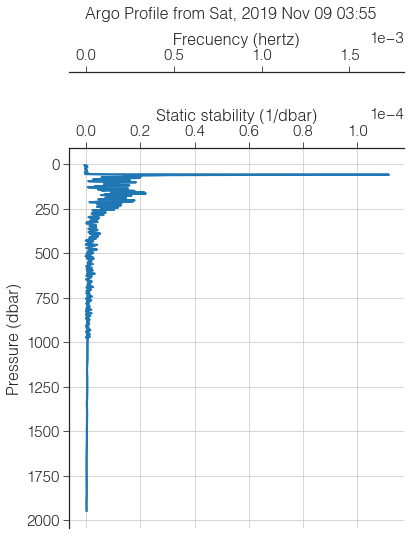

In [24]:
fig, ax1 = plt.subplots(1,1,figsize=(6,7))

plt.suptitle('Argo Profile from %s' % data.juld[nprof].dt.strftime('%a, %Y %b %d %H:%M').values,y=1.16)

p1,=ax1.plot(E, press[:-1])
ax1.set_xlabel('Static stability (1/dbar)' )
ax1.set_ylabel('Pressure (dbar)')
ax1.ticklabel_format(style='sci', axis='x', scilimits=(0,0))

ax2=ax1.twiny()
ax2.spines["top"].set_position(("axes", 1.2))
make_patch_spines_invisible(ax2)
ax2.spines["top"].set_visible(True)
ax2.grid(False)
p2,=ax2.plot(N/2*np.pi, press[:-1])
# p2,=ax2.plot(E*9.8, press[:-1])
ax2.ticklabel_format(style='sci', axis='x', scilimits=(0,0))
ax2.set_xlabel('Frecuency (hertz)' )
# ax2.xaxis.label.set_color(p2.get_color())

simpleaxis(ax1)
ax1.invert_yaxis() #Flip the y-axis
plt.show()

It's important to highlight that in the regions where the static stability is higher, the bouyancy frecuency is also is. This means that a parcel that oscillates in a region with a static stability more positive will oscillate with a high frequency if it's compared with a parcel located in a region less stable. The zone with more static stability concides with the thermocline

In [25]:
# plt.plot(delta_rho, depth[:-1])
# plt.plot(dif_pden, depth[:-1])


# plt.xlabel('Static stability ')
# plt.ylabel('Pressure (dbar)')
# plt.title('Argo Profile from %s' % data.juld[nprof].dt.strftime('%a, %b %d %H:%M').values)

# plt.gca().invert_yaxis() #Flip the y-axis

# Density profile

In order to check the realibility of density calcylations, a profile is shown below.

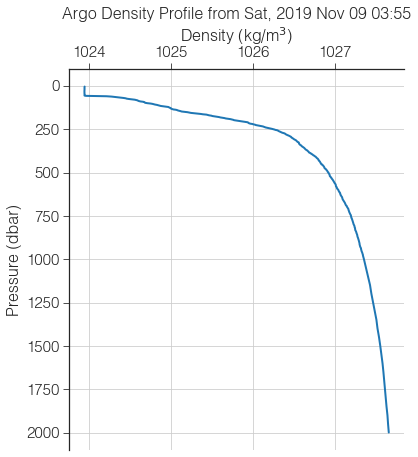

In [26]:
fig=plt.figure(figsize=(6,7))
ax=plt.subplot(111)
ax.plot(rho, press)
ax.set_xlabel('Density (kg/m$^{3}$)')
ax.set_ylabel('Pressure (dbar)')
ax.set_title('Argo Density Profile from %s' % data.juld[nprof].dt.strftime('%a, %Y %b %d %H:%M').values)
simpleaxis(ax)
plt.gca().invert_yaxis() #Flip the y-axis

In [27]:
x = np.arange(0,50)
X, Y=np.meshgrid(x,press.values)
rho_new=np.tile(rho-1000,len(x))
rho_new_reshape=rho_new.reshape((len(x),len(rho)))
tiempo=np.linspace(0,4,1000)

It's expected that the density increases with the pressure (deep). Notice that there are regions where the density vertical gradient is larger. Moreover, in deep layers the density vertical gradient is less. Both regions have different characteristics that will condicionate the vertical motions.

The solutions to eq. \ref{final_v2} are clearly either oscillatory or exponential, according to whether N is real, corresponding to buoyancy oscillations, or imaginary, corresponding to rising/sinking motions. Thus the buoyancy frequency measures the stability of the water column against small vertical perturbations.

If a water parcel is displaced upward in a statically stable water column, it will sink and overshoot the original position. The denser water beneath its original position will force it back up into lighter water, and it will continue oscillating. The frequency of the oscillation depends on the static stability: the more stratified the water column, the higher the static stability and the higher the buoyancy frequency.

In an analysis not shown here can be demonstrated that the vertical displacements have a similar expression:

\begin{equation}
\begin{aligned}
\frac{D^{2} z}{D t^{2}} &=-g\left(\frac{1}{\rho} \frac{\partial \rho}{\partial z}+\frac{g}{c^{2}}\right) z \\
&=N^{2} z
\end{aligned}
\label{final_v3}
\end{equation}

Equation \ref{final_v3} is a homogeneous 2 nd-order differential equation. Although $N^{2}$ is a function of z, in those cases were is a constant then \ref{final_v3} has solutions given by:

\begin{equation}
z(t)=A e^{\sqrt{-N^{2}} t}+B e^{-\sqrt{-N^{2} t}}
\label{desplac}
\end{equation}

These solutions are fundamentally different depending on whether $N^{2}$  is positive or negative.
If $N^{2}$  is positive, $N^{2}$  itself if real, and solutions to \ref{desplac} are:

\begin{equation}
z(t)=A e^{i N t}+B e^{-i N t}
\label{function_displacements_euler}
\end{equation}

which are oscillations having an angular frequency of N. That $N^{2}$ be positive implies that the static stability E, is positive and there is no tendency for vertical overturn. The eq. \ref{function_displacements_euler} can be written as:

\begin{equation}
z(t)= A \sin N t+B \cos N t
\end{equation}

# Animation of static stability and its relation with bouyancy frecuency 

The next animation is used to compare two parcels located in regions with a static stability more positive than another one. The vertical oscillation that will experiment these will be differents due to the bouyancy frequency associated to each region. Both parcels experiment an initial upward desplacements that will start the oscillation.

In [28]:
import matplotlib.patches as patches
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes

#define Matplotlib figure and axis

fig=plt.figure(figsize=(12,8))

gs = gridspec.GridSpec(3, 2)
ax1 = fig.add_subplot(gs[:2, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, 1])
ax4 = fig.add_subplot(gs[2, :])

plt.subplots_adjust(wspace=0.05)

# Main figure with profile
cf=ax1.contourf(X,Y,rho_new_reshape.T,20,cmap='inferno_r')
ax1.invert_yaxis()
ax1.set_ylabel('Pressure (dbar)')
ax1.set(xticklabels=[],xticks=[])

# First zommed axes
location=[20, 250, 10, 100]
limits_x = (20,30)
limits_y = (250, 350)

ax1,ax2,ax11=zoomed_ax(ax1,ax2,location,limits_x,limits_y,'skyblue')
ax11.add_patch(patches.Rectangle((24, 283), 1, 33,facecolor='none',edgecolor='black'))
ax11.axhline(y=300,linestyle='--',color='skyblue',lw=1)

ax2.contourf(X,Y,rho_new_reshape.T,20,cmap='inferno_r')
ax2.invert_yaxis()
ax2.axhline(y=300,linestyle='--',color='skyblue',lw=2)
ax2.add_patch(patches.Rectangle((24, 283), 2, 33,facecolor='none',edgecolor='black'))

# Second zoomed axes
location2=[20, 1500, 10, 100]
limits_x2 = (20,30)
limits_y2 = (1500, 1600)

ax1,ax3,ax12=zoomed_ax(ax1,ax3,location2,limits_x2,limits_y2,'lightcoral')
ax12.add_patch(patches.Rectangle((24, 1533), 1, 33,facecolor='none',edgecolor='white'))
ax12.axhline(y=1550,linestyle='--',color='lightcoral',lw=1)

ax3.contourf(X,Y,rho_new_reshape.T,20,cmap='inferno_r')
ax3.invert_yaxis()
ax3.axhline(y=1550,linestyle='--',color='lightcoral',lw=2)
ax3.add_patch(patches.Rectangle((24, 1533), 2, 33,facecolor='none',edgecolor='white'))

# Creating colorbar
cax= fig.add_axes([ax3.get_position().x1+0.01,ax3.get_position().y0,0.01,ax1.get_position().height])
cbar=plt.colorbar(cf,cax=cax,orientation="vertical",pad=0.15)
cbar.set_label('Density-1000 kg/m$^{3}$',fontsize=16)
cbar.ax.tick_params(labelsize=16)

# set-up time series
ax4.set(ylim=(-4,4),xlim=(0,1),ylabel='Amplitud[m]',xlabel='time[hours]')

for axis in ['top','bottom','left','right']:
    ax11.spines[axis].set_linewidth(2)
    ax11.spines[axis].set_color('skyblue')

for axis in ['top','bottom','left','right']:
    ax12.spines[axis].set_linewidth(2)
    ax12.spines[axis].set_color('lightcoral')
    
recs1=[]
recs2=[]
vert_delta1=[]
vert_delta2=[]
t=[]
line1,=ax4.plot(t,vert_delta1,color='skyblue')
line2,=ax4.plot(t,vert_delta2,color='lightcoral')

def init():
    a=0
    return fig,ax1,ax11,ax12,ax2,ax3,ax4

# # # Next we need to create a function that updates the values for the colormesh, as well as the title.

def animate(frame):
    vertical_displacement1=3*np.cos(3600*(np.sqrt(E[50]*9.8)/2*np.pi)*tiempo[frame])
    vertical_displacement2=3*np.cos(3600*(np.sqrt(E[500]*9.8)/2*np.pi)*tiempo[frame])
    rec1=patches.Rectangle((24, 283+vertical_displacement1), 2, 33,facecolor='skyblue',edgecolor='k')
    rec2=patches.Rectangle((24, 1533+vertical_displacement2), 2, 33,facecolor='lightcoral',edgecolor='white')
    global recs
    global cax
    ax2.add_patch(rec1)
    ax3.add_patch(rec2)
    recs1.append(rec1)
    recs2.append(rec2)
    if frame >0:
        for i,j in zip(recs1[:-1],recs2[:-1]):
            i.set_visible(False)
            j.set_visible(False)
    vert_delta1.append(vertical_displacement1)
    vert_delta2.append(vertical_displacement2)
    t.append(tiempo[frame])
    line1.set_data(t,vert_delta1)
    line2.set_data(t,vert_delta2)
        
# Finally, we use the animation module to create the animation.
ani = animation.FuncAnimation(
    fig,             # figure
    animate,         # name of the function above
    init_func=init,
    frames=260,       # Could also be iterable or list
    interval=200     # ms between frames
)
plt.close()

In [29]:
html=HTML(ani.to_jshtml())

In [30]:
display(html)

**Notice that the oscillations are not dumped due to the viscosity term is not involved. Actually, the water parcels should stop to oscillate in some moment. Also, the initial desplacement is exaggerated in order to see the changes in amplitude.**

In [32]:
ani.save('./sstability_bfreq.gif', writer='imagemagick', fps=1)

If the entire notebook is executed via jupyter notebook, a .GIF file will be downloaded in the current directory where this .ipynb file is.

Parts of the set of equations and some descriptions was taken from the book [Principles of Ocean Physics](https://www.elsevier.com/books/principles-of-ocean-physics/apel/978-0-12-058866-4)

Notebook's author: Franklin Ayala.